In [1]:
# Import all the required module
import os
import glob
import random
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import pandas as pd
import cv2

# Adding seed for reproductivity
random.seed(10)

# Global constant
DATASET_DIR = 'dataset'
TRAINING_CSV = os.path.join(DATASET_DIR, 'train.csv')
TRAINING_IMG_DIR = os.path.join(DATASET_DIR, 'train/')
TESTING_CSV = os.path.join(DATASET_DIR, 'test.csv')
TESTING_IMG_DIR = os.path.join(DATASET_DIR, 'test/')
training_images = glob.glob(TRAINING_IMG_DIR+"*", recursive=False)
testing_images = glob.glob(TESTING_IMG_DIR+"*", recursive=False)

# Cleaning the dataset

In [2]:
# Loading the dataset
dataset = pd.read_csv(TRAINING_CSV, converters={'bbox': eval})
# Checking if any of the field have any nan value
print("Is there any NAN value: ", str(dataset.isnull().values.any()))

Is there any NAN value:  False


In [3]:
# Check if all the bounding box have the correct format
# bbox have this format [xmin, ymin, width, height]
# We will check if any bounding box have width/hegith <= 0
bboxes = np.asarray(dataset.bbox.tolist(), dtype=float)
print("Any bounding boxes width or height have negetive/zero value: ", str(np.any(bboxes[:,2:] <= 0)))
print("Any bounding boxes xmin/ymin have incorrect value: ", str(np.any(bboxes[:,:2] >= 1200)))

Any bounding boxes width or height have negetive/zero value:  False
Any bounding boxes xmin/ymin have incorrect value:  False


In [4]:
# check if there are some images that doesn't have any wheat/ground truth at all
# List of images that have at least one ground truth
unique_image = pd.DataFrame(dataset.image_id.unique(), columns=['image_id'])
print("There are {} that doesn't have any wheat head at all".format(len(training_images) - unique_image.shape[0]))

There are 49 that doesn't have any wheat head at all


In [5]:
# Utility function
def load_image(path):
    img = cv2.imread(path)
    return np.asarray(img)

# Show image with the bounding boxes
def show_single_image_path_with_bounding_box(path, bounding_boxes, conf=1.0):
    """
    This function will print the bounding boxes inside the image
    :param path:
    :param bounding_boxes:
    :param conf
    :return:
    """
    fig, ax = plt.subplots(1)
    for bbox in bounding_boxes:
        rect = patches.Rectangle(xy=[bbox[0], bbox[1]], width=bbox[2], height=bbox[3],
                                 fill=False, edgecolor='red')
        ax.text(bbox[0], bbox[1], str(conf), va='bottom', ha='left', color='red')
        ax.add_patch(rect)
    ax.imshow(load_image(path))
    plt.title(path)
    plt.show()

def show_single_image_id_with_bounding_box(image_id, dataset=dataset):
    single_image_id = dataset.image_id.unique()[image_id]
    single_image_path = os.path.join(TRAINING_IMG_DIR, single_image_id + ".jpg")
    # Get the bounding boxes of image with id `single_image_id`
    dataset_single_image = dataset[dataset['image_id'] == single_image_id]
    single_bounding_boxes = np.array(dataset_single_image["bbox"])
    show_bounding_boxes(single_image_path, single_bounding_boxes)

def show_images_with_bounding_box(ids, dataset=dataset, path=TRAINING_IMG_DIR):
    # Each row will contain two image
    image_per_row = 2
    row_number = max(math.ceil(len(ids)/image_per_row), 1)
    fig, ax = plt.subplots(row_number, image_per_row, figsize=(20, 35), dpi=100)
    for row in range(row_number):
        for column in range(image_per_row):
            # Get the bounding boxes of this image
            try:
                single_image_id = ids[row*image_per_row + column]
            except IndexError:
                continue
            this_image = dataset[dataset['image_id'] == single_image_id]
            bounding_boxes = np.array(this_image['bbox'])
            for bbox in bounding_boxes:
                if len(bbox) == 5: # it has the confidence label so we will print that
                    rect = patches.Rectangle(xy=[bbox[1], bbox[2]], width=bbox[3], height=bbox[4],
                                             fill=False, edgecolor='red')
                    ax[row, column].text(bbox[1], bbox[2], str(bbox[0]), va='bottom', ha='left', color='red')
                else:  # This doesn't have the confidence level
                    rect = patches.Rectangle(xy=[bbox[0], bbox[1]], width=bbox[2], height=bbox[3],
                                             fill=False, edgecolor='red')
                ax[row, column].add_patch(rect)
            ax[row, column].imshow(load_image(TRAINING_IMG_DIR + single_image_id + ".jpg"))
            ax[row, column].set_title(single_image_id)
            
# Find the number of bounding boxes for each images
def count_bounding_boxes(dataset=dataset):
    bbox_count_df = pd.DataFrame(dataset.groupby(['image_id']).count()['bbox'])
    bbox_count_df.rename(columns={'bbox': 'bbox_count'}, inplace=True)
    return bbox_count_df

# Find the brightness of the image
def get_brightness(unique_image=unique_image):
    unique_image['brightness'] = ''
    for index, row in unique_image.iterrows():
        image_path = TRAINING_IMG_DIR + row['image_id'] + '.jpg'
        image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2GRAY)
        unique_image.iloc[index]['brightness'] = image.mean()
    unique_image['brightness'] = unique_image['brightness'].astype(float)
    return unique_image

# Visualize the dataset

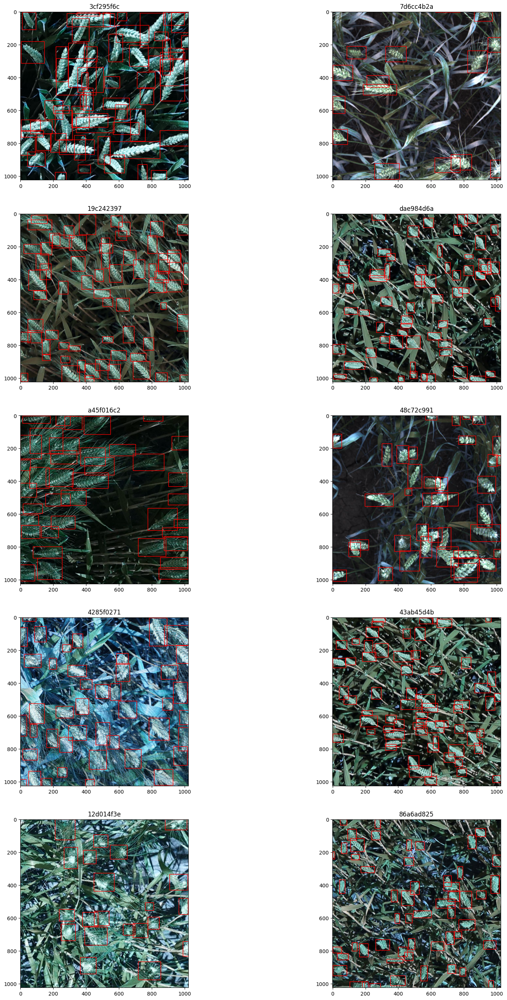

In [6]:
ids = random.sample(list(unique_image.image_id), k=10)
# Show some random images
show_images_with_bounding_box(ids)

Each image have on avarage  43.8164838422769  wheat in it with the SD  20.37481963254714


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x12b9a6590>]],
      dtype=object)

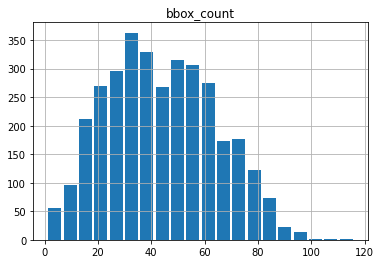

In [7]:
# Number of bounding box in for each image
dataset.head()
bbox_count_df = count_bounding_boxes()
bbox_count_des = bbox_count_df.describe()["bbox_count"]
print("Each image have on avarage ", str(bbox_count_des["mean"]), " wheat in it with the SD ", str(bbox_count_des['std']))
bbox_count_df.hist(bins=20, rwidth=.85)

### Having less amount of wheat head

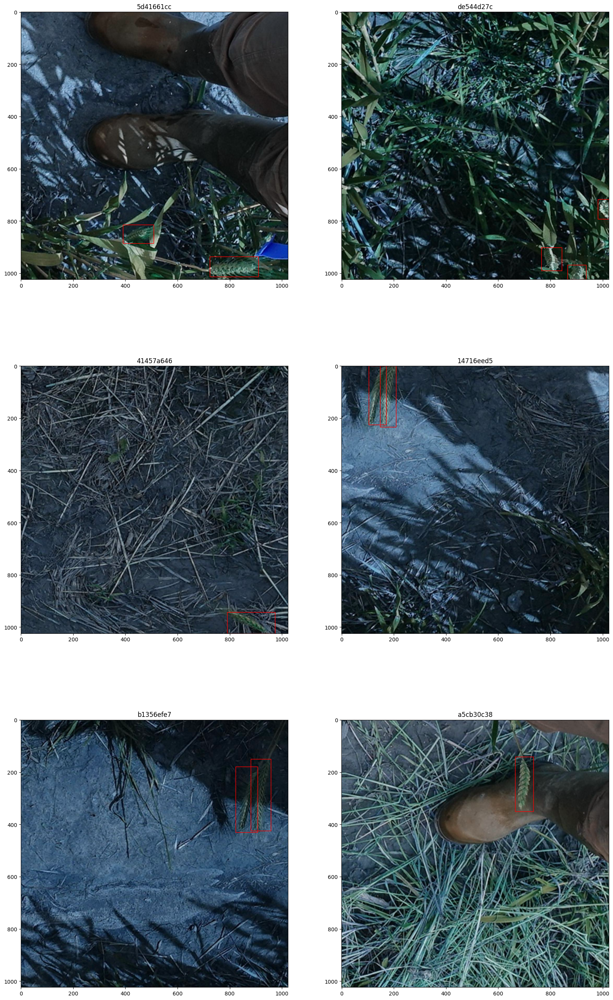

In [8]:
# Example of images having less wheat head
bbox_count_less = bbox_count_df[bbox_count_df['bbox_count'] <= 3].index.tolist()
# Print random 6 element from this
bbox_less_rand = random.sample(bbox_count_less, k=6)
show_images_with_bounding_box(bbox_less_rand)

### Having high amount of wheat head

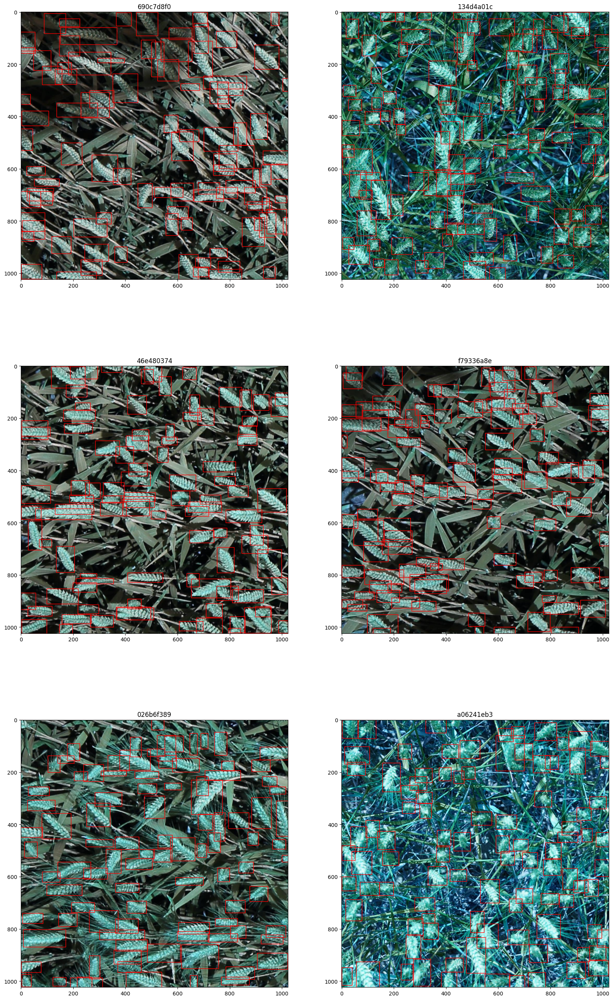

In [9]:
# Example images having hight wheat head
bbox_count_high = bbox_count_df[bbox_count_df['bbox_count'] >= 95].index.tolist()
# print randm 6 element from this
bbox_high_rand = random.sample(bbox_count_high, k=6)
show_images_with_bounding_box(bbox_high_rand)

# Some of the brightest image

In [10]:
unique_image = get_brightness()
unique_image.describe()

,brightness
count,3373.000000
mean,77.738199
std,25.761696
min,20.159955
25%,58.381242
50%,77.366381
75%,100.273308
max,164.207220


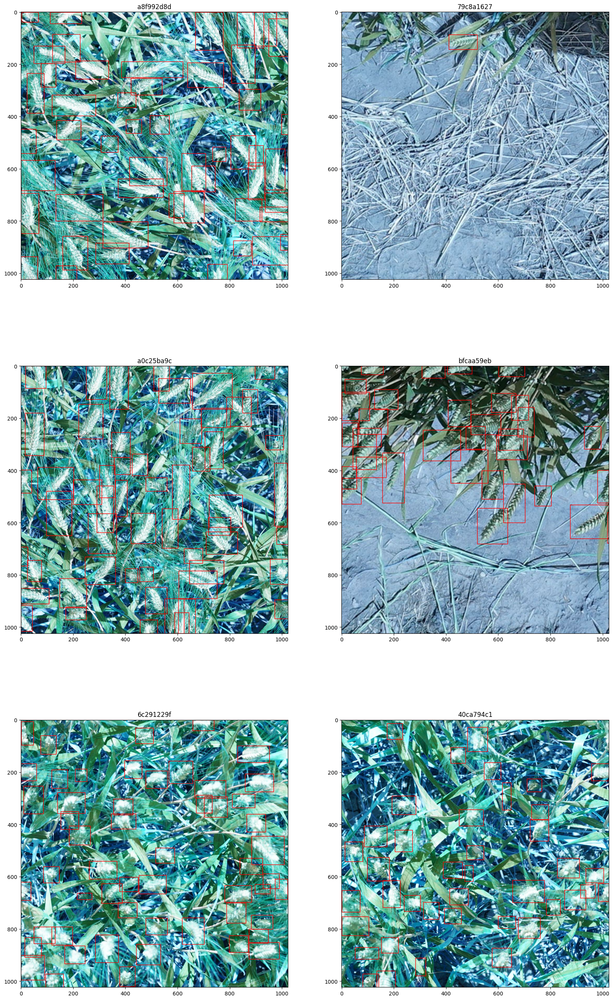

In [11]:
unique_image_brightest = random.sample(unique_image[unique_image['brightness'] > 140].image_id.tolist(), k=6)
show_images_with_bounding_box(unique_image_brightest)

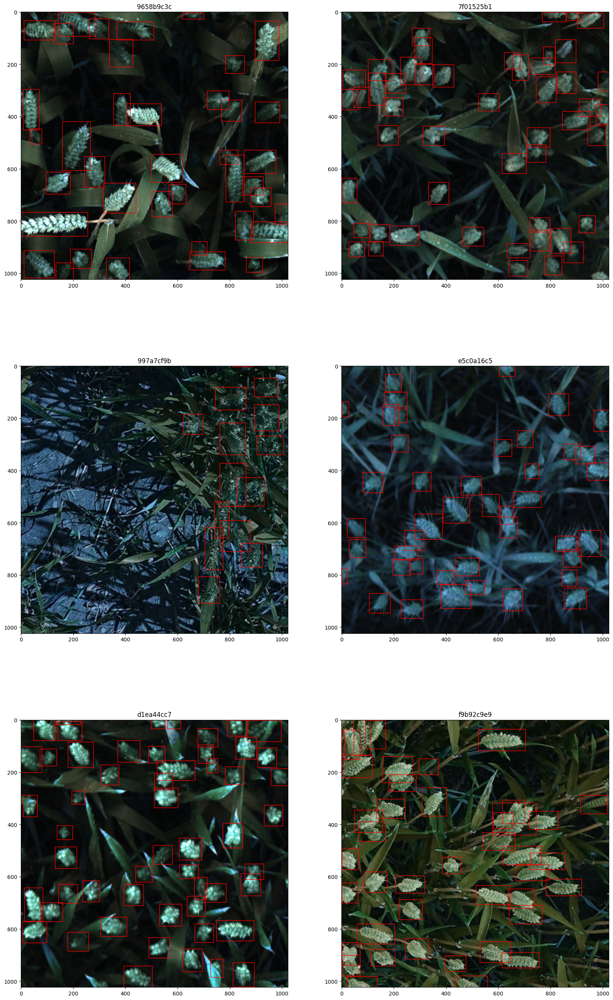

In [12]:
unique_image_dark = random.sample(unique_image[unique_image['brightness'] < 50].image_id.tolist(), k=6)
show_images_with_bounding_box(unique_image_dark)